# Prep

In [3]:
import pyforest
import phik

# from plotnine import *

import plotly.io as pio
#pio.templates.default = "plotly_white"
pio.templates.default = "seaborn"

px.defaults.color_continuous_scale = px.colors.sequential.Blues
#px.defaults.color_continuous_scale = px.colors.sequential.Viridis_r
px.defaults.width = 1200
px.defaults.height = 600

sns.set(style='darkgrid')

pd.options.plotting.backend = "plotly"

%config InlineBackend.figure_format='retina'
%load_ext rpy2.ipython

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [2]:
%%R

library(tidyverse)
# library(lvplot)
library(patchwork)
library(plotly)
library(viridis)
library(here)

theme_set(theme_bw())

neuron_label = 'Latent dimensions sorted by relevance'
feature_label = 'Music features'

rel_size = 2
width = 16
height = 8

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors



Attaching package: ‘plotly’

The following object is masked from ‘package:ggplot2’:

    last_plot

The following object is masked from ‘package:stats’:

    filter

The following object is masked from ‘package:graphics’:

    layout

Loading required package: viridisLite
here() starts at /Users/johannes/work/music


In [4]:
from music21 import *

k_s = []
i_s = []
n_s = []

fs = features.jSymbolic.extractorsById
for k in fs:
    for i in range(len(fs[k])):
      if fs[k][i] is not None:
        n = fs[k][i].__name__
        if fs[k][i] not in features.jSymbolic.featureExtractors:
           n += ' (not implemented)'
        k_s.append(k)
        i_s.append(i)
        n_s.append(n)
        #print(f'{k} {i} {n}')

feat_names = pd.DataFrame({'type':k_s,'number':i_s,'name':n_s})
#feat_names['name'] = feat_names.name.str.split('Feature')
feat_names['name'] = feat_names['name'].str.replace('Feature','')
feat_names['name'] = feat_names['name'].apply(lambda text: ''.join(' ' + char if char.isupper() else char.strip() for char in text).strip())
feat_names['code'] = feat_names['type'] + feat_names['number'].astype(str)#+'_1/1'
feat_names['name'] = feat_names['type'] + feat_names['number'].astype(str)+': '+feat_names['name']
feat_names

<IPython.core.display.Javascript object>

,type,number,name,code
0,D,1,D1: Overall Dynamic Range(notimplemented),D1
1,D,2,D2: Variation Of Dynamics(notimplemented),D2
2,D,3,D3: Variation Of Dynamics In Each Voice(notimp...,D3
3,D,4,D4: Average Note To Note Dynamics Change(notim...,D4
4,I,1,I1: Pitched Instruments Present,I1
...,...,...,...,...
107,T,10,T10: Relative Range Of Loudest Voice(notimplem...,T10
108,T,12,T12: Range Of Highest Line(notimplemented),T12
109,T,13,T13: Relative Note Density Of Highest Line(not...,T13
110,T,15,T15: Melodic Intervals In Lowest Line(notimple...,T15


# Read data

In [22]:
n_bars = '16bar' #@param ['2bar','16bar']
data_type = 'lmd_matched' #@param ['lmd_matched','random']
 
path = Path('.') /'outputs' / data_type
read_path = path / n_bars
path = read_path
save_path = path

fig_path = Path('.') / 'figures'
fig_path.mkdir(parents=True,exist_ok=True)

encodings = pd.read_csv(read_path / 'latent_encodings.csv')
sigmas  = pd.read_csv(read_path / 'encoding_sigmas.csv')

if data_type == 'lmd_matched':
    encodings = encodings.set_index(['msd_id', 'midi_md5', 'melody_number'])
    sigmas = sigmas.set_index(['msd_id', 'midi_md5', 'melody_number'])

if data_type == 'random':
    encodings = encodings.set_index('datetime')
    sigmas = sigmas.set_index('datetime')

encodings.columns = range(512)
encodings.columns = encodings.columns.astype(str)
sel_latents = encodings

sigmas.columns = sigmas.columns.astype(str)

jsymb = pd.read_csv(read_path / 'extracted_jsymb.csv')

if data_type == 'lmd_matched':
    jsymb = jsymb.set_index(['msd_id', 'midi_md5', 'melody_number'])

jsymb = jsymb.iloc[:,list(jsymb.nunique() != 1)]
jsymb.shape, encodings.shape, sigmas.shape

mus = encodings

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Sigmas and relevant latents

In [23]:
meds = sigmas.mean().sort_values()
# meds = sigmas.median().sort_values()

meds.iloc[:10]

470    0.014810
507    0.015210
14     0.019858
282    0.021716
191    0.036691
289    0.044942
33     0.047043
30     0.051592
163    0.052032
394    0.054169
dtype: float64

In [31]:
results = pd.DataFrame()
n_samples = []
for n in np.arange(2.3, 9.4, .1):
    # = 10 * 1000
    n_sample = int(np.ceil(np.exp(n)))
    n_samples.append(n_sample)
    results = pd.concat([results, (mus.sample(n = n_sample).std() / sigmas.sample(n = n_sample).mean()).sort_values(ascending=False).to_frame().T], ignore_index=True)
results['n_samples'] = n_samples
# results = results.T
results

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,470,507,282,14,394,30,289,101,133,163,...,4,234,207,434,192,10,276,221,393,n_samples
0,139.299735,93.320948,69.795284,42.542912,27.591966,25.383436,25.256238,22.269454,21.385016,21.100457,...,0.053910,0.053875,0.048430,0.044095,0.041431,0.040134,0.040006,0.033295,0.029565,10
1,61.287519,83.506562,62.247897,89.707720,18.396546,16.101644,24.521995,15.998192,16.797953,21.221531,...,0.094814,0.093142,0.065285,0.127852,0.090379,0.062730,0.091852,0.066177,0.067848,12
2,72.980494,56.927881,81.817094,70.581834,20.599859,18.796593,30.393414,11.737511,20.890066,21.560956,...,0.087168,0.072237,0.046117,0.128937,0.116151,0.082484,0.112246,0.055093,0.049674,13
3,118.303194,106.444206,42.407966,51.019699,21.323606,27.844223,31.262305,12.846721,23.434542,15.542537,...,0.091137,0.106666,0.059769,0.113361,0.099490,0.083221,0.110091,0.090187,0.037832,14
4,63.829420,55.473935,71.585800,79.503504,18.273558,11.779310,12.262797,10.927478,10.170096,17.861873,...,0.077033,0.084176,0.055847,0.085322,0.087328,0.075011,0.073296,0.054866,0.047885,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66,78.881370,69.386787,67.119695,66.447696,16.644893,17.098517,22.407548,13.895196,16.156876,17.793390,...,0.115926,0.093032,0.061423,0.098349,0.107453,0.079613,0.101495,0.063205,0.052287,7332
67,78.066741,69.200882,67.058460,66.601681,16.755241,17.140543,22.329041,14.230055,15.929245,17.555169,...,0.114401,0.091452,0.060840,0.099059,0.106158,0.080303,0.102009,0.064292,0.052770,8104
68,78.470713,69.144457,67.628686,66.796035,16.826150,16.997108,22.119137,14.096940,15.929323,17.647900,...,0.114006,0.090520,0.061450,0.098029,0.105593,0.079867,0.101131,0.062829,0.052120,8956
69,79.923913,69.965284,68.472705,67.416697,16.489633,17.214022,22.564873,14.095702,16.062628,17.806192,...,0.115044,0.092654,0.060542,0.097375,0.105668,0.079776,0.100835,0.062895,0.052512,9898


In [32]:
results = results.melt(id_vars='n_samples')
results

,n_samples,variable,value
0,10,470,139.299735
1,12,470,61.287519
2,13,470,72.980494
3,14,470,118.303194
4,15,470,63.829420
...,...,...,...
36347,7332,393,0.052287
36348,8104,393,0.052770
36349,8956,393,0.052120
36350,9898,393,0.052512


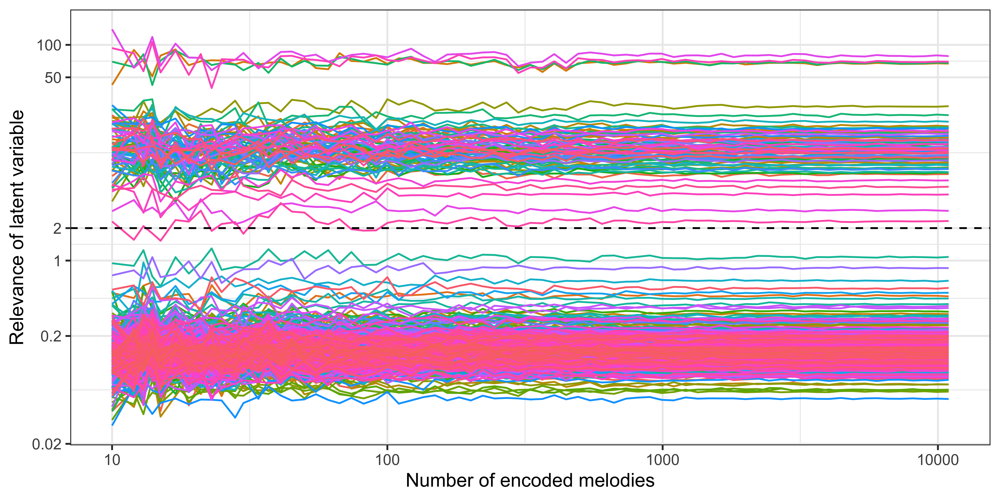

In [33]:
%%R -i n_bars,results -w 8 -h 4 -u in -r 600
# library(viridis)

if (n_bars == '2bar'){breaks = c(.05, .5, 5, 15, 50)
                     y=.5}
if (n_bars == '16bar'){breaks = c(.02, .2, 1, 2, 50, 100)
                       # lim= c(.02, NA)
                      y = 2}

p = results %>%
    ggplot(aes(x=n_samples, y=value, color=variable)) +
    geom_line(show.legend=F) +
    scale_x_log10(breaks=c(1, 10, 100, 1000, 10000), lim=c(10, NA)) +
    scale_y_log10(breaks=breaks, labels=breaks) + 
    geom_hline(yintercept = y, color = "black", lty = "dashed") +
    labs(x='Number of encoded melodies',
         y='Relevance of latent variable')
    
p

In [82]:
%%R
ggsave(here('figures', paste(n_bars, 'relevance.png', sep='_')), width=6, height=4)
ggsave(here('figures', paste(n_bars, 'relevance.pdf', sep='_')), width=6, height=4)


In [34]:
if n_bars == '2bar':
    cutoff = .5
if n_bars == '16bar':
    cutoff = 2
    
ratios = (mus.std() / sigmas.mean()).sort_values(ascending=False)
latents_sorted = list(map(str, ratios.index.tolist()))
relevant = ratios[ratios > cutoff]
n_relevant = len(relevant)
separation = n_relevant + .5
n_relevant

77

In [35]:
ratios.iloc[:10]

470    78.888031
507    70.015735
282    67.922358
14     67.264840
191    26.825293
289    22.219938
33     19.428618
163    17.721863
30     17.114563
394    16.675590
dtype: float64

In [36]:
list(map(int, latents_sorted[:n_relevant]))

[470,
 507,
 282,
 14,
 191,
 289,
 33,
 163,
 30,
 394,
 133,
 477,
 16,
 118,
 140,
 297,
 451,
 398,
 123,
 101,
 168,
 355,
 496,
 82,
 421,
 280,
 363,
 272,
 423,
 502,
 251,
 335,
 460,
 165,
 119,
 203,
 95,
 356,
 210,
 13,
 484,
 18,
 382,
 235,
 81,
 249,
 68,
 147,
 310,
 412,
 390,
 275,
 369,
 97,
 405,
 403,
 248,
 263,
 208,
 281,
 430,
 155,
 300,
 154,
 336,
 185,
 3,
 236,
 400,
 314,
 246,
 107,
 486,
 69,
 504,
 474,
 58]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

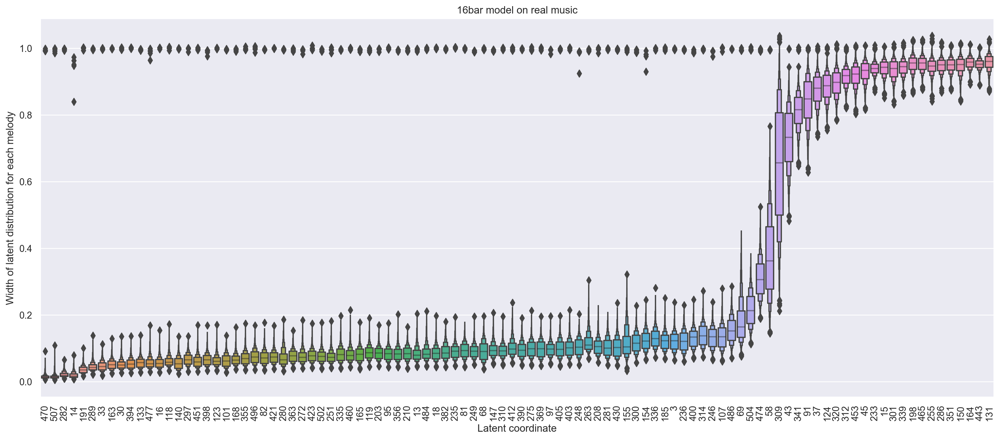

In [37]:
n_tot = 100
data = sigmas[latents_sorted].iloc[:,:n_tot]

sns.set(rc={"figure.figsize":(20,8)})
fig = sns.boxenplot(data = data)
fig.axes.tick_params(axis='x', labelrotation= 90)
fig.axes.set(
    title = str(n_bars)+' model on real music'
    ,ylabel='Width of latent distribution for each melody'
    ,xlabel='Latent coordinate'
);

In [38]:
%%R -i data,latents_sorted

data_long = data %>%
    pivot_longer(
    cols = everything(),
    names_to = "neuron", 
    values_to = "sigma", 
    values_drop_na = FALSE
  ) %>%
    mutate(neuron = factor(neuron, latents_sorted))

data_long

# A tibble: 1,171,500 × 2
   neuron   sigma
   <fct>    <dbl>
 1 470    0.00733
 2 507    0.00678
 3 282    0.0111 
 4 14     0.00946
 5 191    0.0207 
 6 289    0.0271 
 7 33     0.0417 
 8 163    0.0303 
 9 30     0.0317 
10 394    0.0333 
# ℹ 1,171,490 more rows
# ℹ Use `print(n = ...)` to see more rows


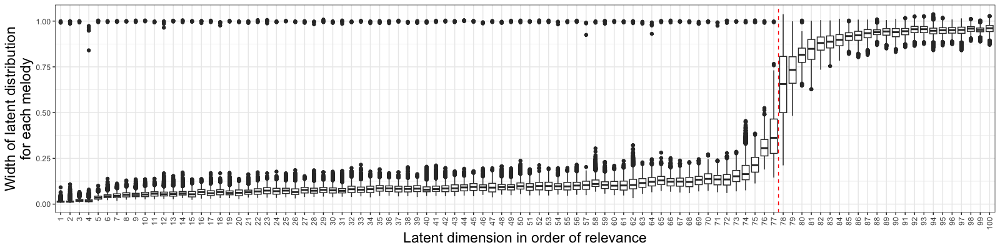

In [39]:
%%R -i n_tot,n_bars,separation -w 1600 -h 400 --unit px -r 100

neuron_label = 'Latent dimension in order of relevance'

p_sigmas = data_long %>%
    ggplot(aes(neuron, sigma)) + #data_long, aes(reorder(neuron, sigma), sigma)) +
    geom_boxplot() +
    guides(x = guide_axis(angle = 90)) +
    # # theme(axis.text.x = element_text(size=rel(rel_size))) +
    scale_x_discrete(labels=seq(1,n_tot)) + #breaks=order,
    geom_vline(xintercept = c(separation), color = "red", lty = "dashed") +
    labs(x=neuron_label, y="Width of latent distribution\nfor each melody") +
    theme(axis.title = element_text(size=rel(1.5)))
    
ggsave(here('figures', paste(n_bars, 'sigmas.png', sep='_')), width=width, height=4)
ggsave(here('figures', paste(n_bars, 'sigmas.pdf', sep='_')), width=width, height=4)

p_sigmas

In [40]:
%%R -i ratios -w 1600 -h 400 --unit px -r 100

ratios %>%
    as_tibble() %>%
    mutate(number = row_number())

# A tibble: 512 × 2
   value number
   <dbl>  <int>
 1  78.9      1
 2  70.0      2
 3  67.9      3
 4  67.3      4
 5  26.8      5
 6  22.2      6
 7  19.4      7
 8  17.7      8
 9  17.1      9
10  16.7     10
# ℹ 502 more rows
# ℹ Use `print(n = ...)` to see more rows


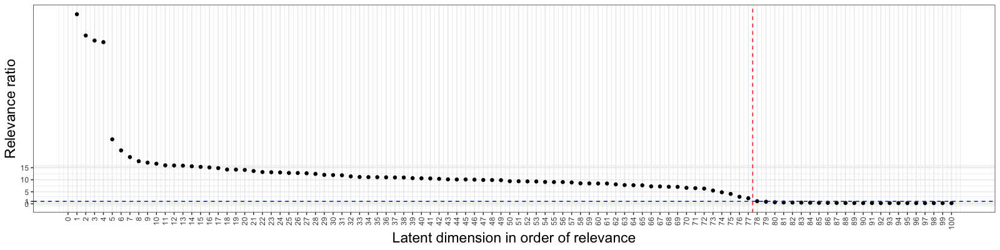

In [41]:
%%R -i ratios -w 1600 -h 400 --unit px -r 100

ratios %>%
    as_tibble() %>%
    mutate(number = row_number()) %>%
    filter(number <= n_tot) %>%
    ggplot(aes(number, value)) +
    geom_point() +
    guides(x = guide_axis(angle = 90)) +
    # # theme(axis.text.x = element_text(size=rel(rel_size))) +
    # scale_x_discrete(labels=seq(1,100)) + #breaks=order,
    scale_x_continuous(breaks=seq(0,n_tot)) +
    scale_y_continuous(breaks=c(0,1,5,10, 15)) +
    geom_hline(yintercept = 1, color = "blue", lty = "dashed") +
    geom_vline(xintercept = separation, color = "red", lty = "dashed") +
    labs(x=neuron_label, y="Relevance ratio") +
    theme(axis.title = element_text(size=rel(1.5)))
   

# Study latent dimensions

In [42]:
relevant.index.tolist()[:10]

['470', '507', '282', '14', '191', '289', '33', '163', '30', '394']

In [43]:
mus = encodings[latents_sorted].iloc[:,:n_tot]
mus

470  \
msd_id             midi_md5                         melody_number             
TRZJOHN128F931B242 840cc556137f98edffce18bda23b19d1 0              0.072969   
                                                    1             -1.536722   
                                                    2              1.107579   
                                                    3              0.794777   
TRSOOHR128F93259C8 ee54df3c6dc423c107cfa81666149dd8 0             -0.943636   
...                                                                     ...   
TRCHGMG128F428EA87 6b7b97af1d9a30bf499d585536e219e9 0              0.037943   
                                                    1             -0.091707   
                                                    2             -0.048714   
                                                    3              0.019743   
                                                    4              0.036160   

                                                                        507  \
msd_id             midi_md5                         melody_number             
TRZJOHN128F931B242 840cc556137f98edffce18bda23b19d1 0             -2.521086   
                                                    1              0.134882   
                                                    2              0.709131   
                                                    3              0.260096   
TRSOOHR128F93259C8 ee54df3c6dc423c107cfa81666149dd8 0             -0.147691   
...                                                                     ...   
TRCHGMG128F428EA87 6b7b97af1d9a30bf499d585536e219e9 0             -0.060183   
                                                    1             -0.069376   
                                                    2             -0.075925   
                                                    3              0.053878   
                                                    4             -0.043429   

                                                                        282  \
msd_id             midi_md5                         melody_number             
TRZJOHN128F931B242 840cc556137f98edffce18bda23b19d1 0              0.814663   
                                                    1              1.962289   
                                                    2             -0.724364   
                                                    3              0.850019   
TRSOOHR128F93259C8 ee54df3c6dc423c107cfa81666149dd8 0              0.554255   
...                                                                     ...   
TRCHGMG128F428EA87 6b7b97af1d9a30bf499d585536e219e9 0              0.138819   
                                                    1             -0.008564   
                                                    2             -0.117378   
                                                    3             -0.050228   
                                                    4              0.137522   

                                                                         14  \
msd_id             midi_md5                         melody_number             
TRZJOHN128F931B242 840cc556137f98edffce18bda23b19d1 0              0.049018   
                                                    1              0.159856   
                                                    2              0.259626   
                                                    3             -0.258637   
TRSOOHR128F93259C8 ee54df3c6dc423c107cfa81666149dd8 0              0.066050   
...                                                                     ...   
TRCHGMG128F428EA87 6b7b97af1d9a30bf499d585536e219e9 0             -0.319766   
                                                    1              0.602920   
                                                    2             -0.057362   
                                                    3             -0.241704   
                                        

/Users/johannes/opt/anaconda3/envs/magenta/lib/python3.7/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '


In addition: Warning message:
There was 1 warning in `mutate()`.
ℹ In argument: `neuron = fct_relevel(neuron, order)`.
Caused by warning:
! 412 unknown levels in `f`: 52, 171, 260, 180, 337, 409, 103, 20, 122, 482, 302,
209, 110, 277, 296, 162, 129, 278, …, 207, and 393 


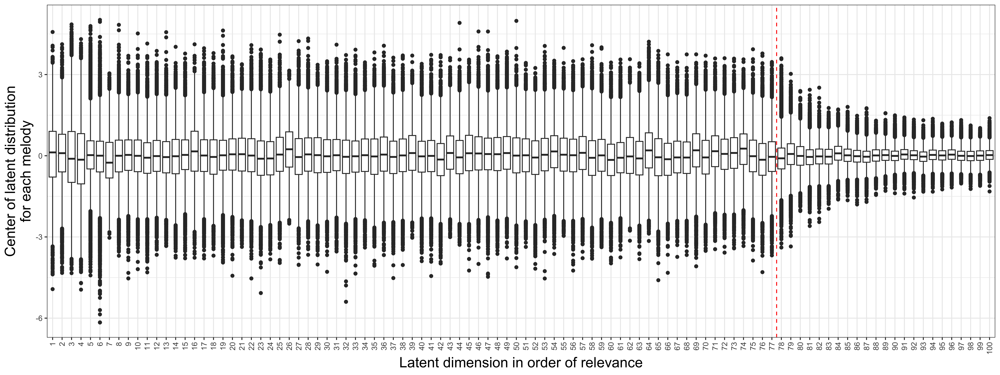

In [44]:
%%R -i mus -w 16 -h 6 --unit in -r 400

order = latents_sorted
p_mus = mus %>%
    pivot_longer(
        cols = everything(),
        names_to = "neuron", 
        values_to = "mu", 
        values_drop_na = FALSE
    ) %>%
    mutate(neuron = fct_relevel(neuron, order)) %>%
    ggplot() +
    geom_boxplot(aes(neuron, mu)) +
    guides(x = guide_axis(angle = 90)) +
    # theme(axis.text.x = element_text(size=rel(rel_size))) +
    scale_x_discrete(labels=seq(1,n_tot)) +  #breaks=order,
    geom_vline(xintercept = c(separation), color = "red", lty = "dashed") + 
    labs(x=neuron_label, y="Center of latent distribution\nfor each melody") +
    theme(axis.title = element_text(size=rel(1.5)))

ggsave(here('figures', paste(n_bars, 'mus.png', sep='_')), width=width, height=4)
ggsave(here('figures', paste(n_bars, 'mus.pdf', sep='_')), width=width, height=4)

p_mus

In [45]:
order = latents_sorted
n_lats = n_tot

keep_latents = order[:n_lats]
sel_latents = encodings[keep_latents]

### Plot the standard deviation of each latent coordinate

In [46]:
data = encodings.apply([np.mean,np.std],axis=0).T.reindex(order)
data['mean_abs'] = data['mean'].abs()
data['sigmas_away'] = data['mean_abs'] / data['std']
data

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,mean,std,mean_abs,sigmas_away
470,0.059972,1.168337,0.059972,0.051331
507,0.082573,1.064948,0.082573,0.077538
282,0.030095,1.474995,0.030095,0.020403
14,-0.093511,1.335743,0.093511,0.070007
191,0.036570,0.984247,0.036570,0.037156
...,...,...,...,...
194,0.000276,0.070062,0.000276,0.003944
214,0.000161,0.062825,0.000161,0.002558
221,0.012858,0.062602,0.012858,0.205385
207,0.007416,0.060292,0.007416,0.123001


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

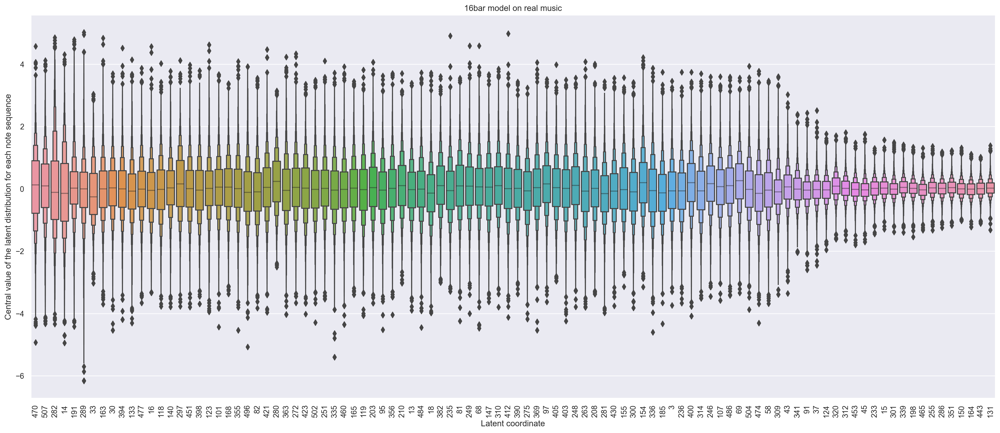

In [47]:
sns.set(rc={"figure.figsize":(25,10)})

fig = sns.boxenplot(data = encodings[order[:100]])
fig.axes.tick_params(axis='x', labelrotation= 90)
fig.axes.set(
    title = str(n_bars)+' model on real music',
    ylabel='Central value of the latent distribution for each note sequence'
    ,xlabel='Latent coordinate'
);

# Neuron-neuron correlations

In [48]:
sorted_neurons = latents_sorted

<h2>Compute correlations</h2>

In [386]:
#if instead of the mus, we wanted to check complete diagonalization of the samples
#encodings = pd.read_csv(os.path.join(read_path,'encoding_samples.csv'))

In [49]:
pearson_corr_mus = encodings[sorted_neurons[:]].corr().pipe(np.abs)
pearson_corr_mus.to_parquet(save_path / 'pearson_corr_mus.parquet')

<IPython.core.display.Javascript object>

In [50]:
eye = pd.DataFrame(np.eye(len(pearson_corr_mus)),index=pearson_corr_mus.index,columns=pearson_corr_mus.columns)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

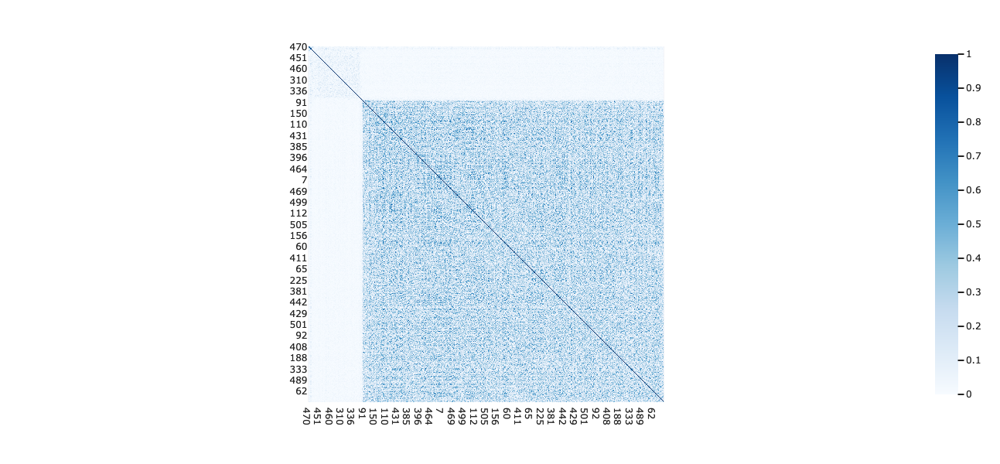

In [51]:
pearson_corr_mus.abs().plot(kind='imshow')

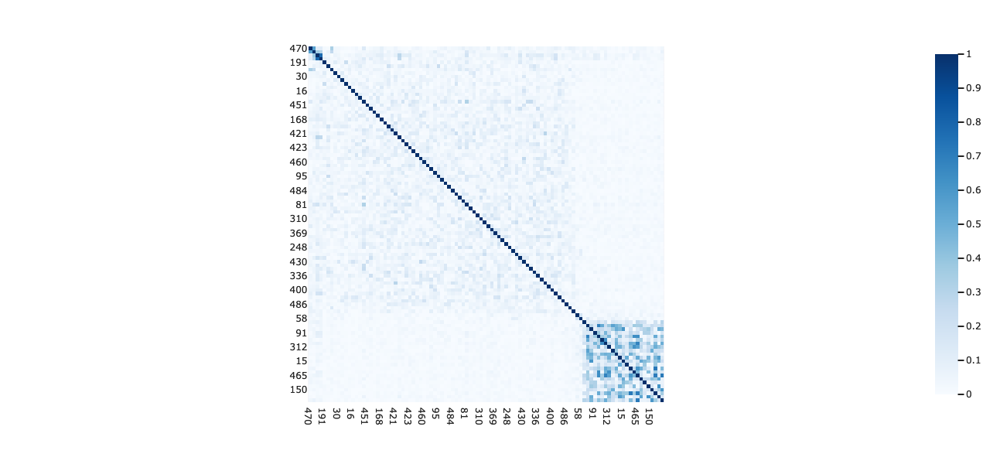

In [52]:
pearson_corr_mus.iloc[:n_tot,:n_tot].abs().plot(kind='imshow')

<IPython.core.display.Javascript object>

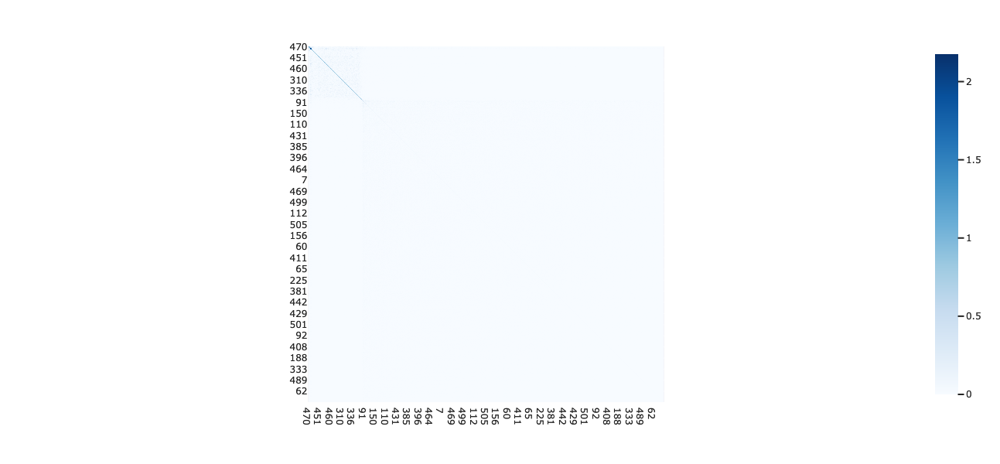

In [53]:
encodings[order[:]].cov().pipe(np.abs).plot(kind='imshow')

In [54]:
n_feats = n_tot

## Pearson correlations between neurons

In [55]:
pearson_corr_mus.reset_index()

,index,470,507,282,14,191,289,33,163,30,...,332,50,10,39,166,194,214,221,207,393
0,470,1.000000,0.564712,0.097844,0.112113,0.015388,0.009044,0.336986,0.032558,0.030052,...,0.034155,0.025772,0.001765,0.042736,0.012981,0.016329,0.033507,0.005602,0.005652,0.077624
1,507,0.564712,1.000000,0.368408,0.305482,0.019669,0.081213,0.262533,0.034909,0.024073,...,0.078617,0.006208,0.037338,0.046226,0.033699,0.016417,0.043336,0.031977,0.026585,0.105379
2,282,0.097844,0.368408,1.000000,0.777527,0.047548,0.046878,0.003470,0.053540,0.041419,...,0.078686,0.102831,0.090919,0.014082,0.055306,0.039069,0.015544,0.076349,0.000270,0.064726
3,14,0.112113,0.305482,0.777527,1.000000,0.103572,0.067620,0.026914,0.021821,0.060138,...,0.062556,0.089939,0.108809,0.016349,0.046781,0.009923,0.010663,0.073698,0.012697,0.070295
4,191,0.015388,0.019669,0.047548,0.103572,1.000000,0.023829,0.035196,0.119692,0.055227,...,0.002441,0.015873,0.004989,0.023854,0.002438,0.022465,0.012574,0.008135,0.018992,0.013782
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
507,194,0.016329,0.016417,0.039069,0.009923,0.022465,0.021725,0.029471,0.024832,0.001579,...,0.058913,0.081952,0.240069,0.245135,0.098697,1.000000,0.184079,0.183313,0.306027,0.086278
508,214,0.033507,0.043336,0.015544,0.010663,0.012574,0.028753,0.002025,0.009144,0.017317,...,0.006192,0.179179,0.112374,0.617953,0.196056,0.184079,1.000000,0.144925,0.187202,0.200856
509,221,0.005602,0.031977,0.076349,0.073698,0.008135,0.029820,0.001262,0.035427,0.006855,...,0.101023,0.321513,0.659619,0.062207,0.193763,0.183313,0.144925,1.000000,0.056462,0.103141
510,207,0.005652,0.026585,0.000270,0.012697,0.018992,0.010595,0.007540,0.011117,0.003955,...,0.334860,0.432781,0.310211,0.189939,0.179602,0.306027,0.187202,0.056462,1.000000,0.427817


In [56]:
corrs_neurons = pearson_corr_mus.reset_index().rename(columns={'index' : 'neuron_1'})
corrs_neurons

,neuron_1,470,507,282,14,191,289,33,163,30,...,332,50,10,39,166,194,214,221,207,393
0,470,1.000000,0.564712,0.097844,0.112113,0.015388,0.009044,0.336986,0.032558,0.030052,...,0.034155,0.025772,0.001765,0.042736,0.012981,0.016329,0.033507,0.005602,0.005652,0.077624
1,507,0.564712,1.000000,0.368408,0.305482,0.019669,0.081213,0.262533,0.034909,0.024073,...,0.078617,0.006208,0.037338,0.046226,0.033699,0.016417,0.043336,0.031977,0.026585,0.105379
2,282,0.097844,0.368408,1.000000,0.777527,0.047548,0.046878,0.003470,0.053540,0.041419,...,0.078686,0.102831,0.090919,0.014082,0.055306,0.039069,0.015544,0.076349,0.000270,0.064726
3,14,0.112113,0.305482,0.777527,1.000000,0.103572,0.067620,0.026914,0.021821,0.060138,...,0.062556,0.089939,0.108809,0.016349,0.046781,0.009923,0.010663,0.073698,0.012697,0.070295
4,191,0.015388,0.019669,0.047548,0.103572,1.000000,0.023829,0.035196,0.119692,0.055227,...,0.002441,0.015873,0.004989,0.023854,0.002438,0.022465,0.012574,0.008135,0.018992,0.013782
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
507,194,0.016329,0.016417,0.039069,0.009923,0.022465,0.021725,0.029471,0.024832,0.001579,...,0.058913,0.081952,0.240069,0.245135,0.098697,1.000000,0.184079,0.183313,0.306027,0.086278
508,214,0.033507,0.043336,0.015544,0.010663,0.012574,0.028753,0.002025,0.009144,0.017317,...,0.006192,0.179179,0.112374,0.617953,0.196056,0.184079,1.000000,0.144925,0.187202,0.200856
509,221,0.005602,0.031977,0.076349,0.073698,0.008135,0.029820,0.001262,0.035427,0.006855,...,0.101023,0.321513,0.659619,0.062207,0.193763,0.183313,0.144925,1.000000,0.056462,0.103141
510,207,0.005652,0.026585,0.000270,0.012697,0.018992,0.010595,0.007540,0.011117,0.003955,...,0.334860,0.432781,0.310211,0.189939,0.179602,0.306027,0.187202,0.056462,1.000000,0.427817


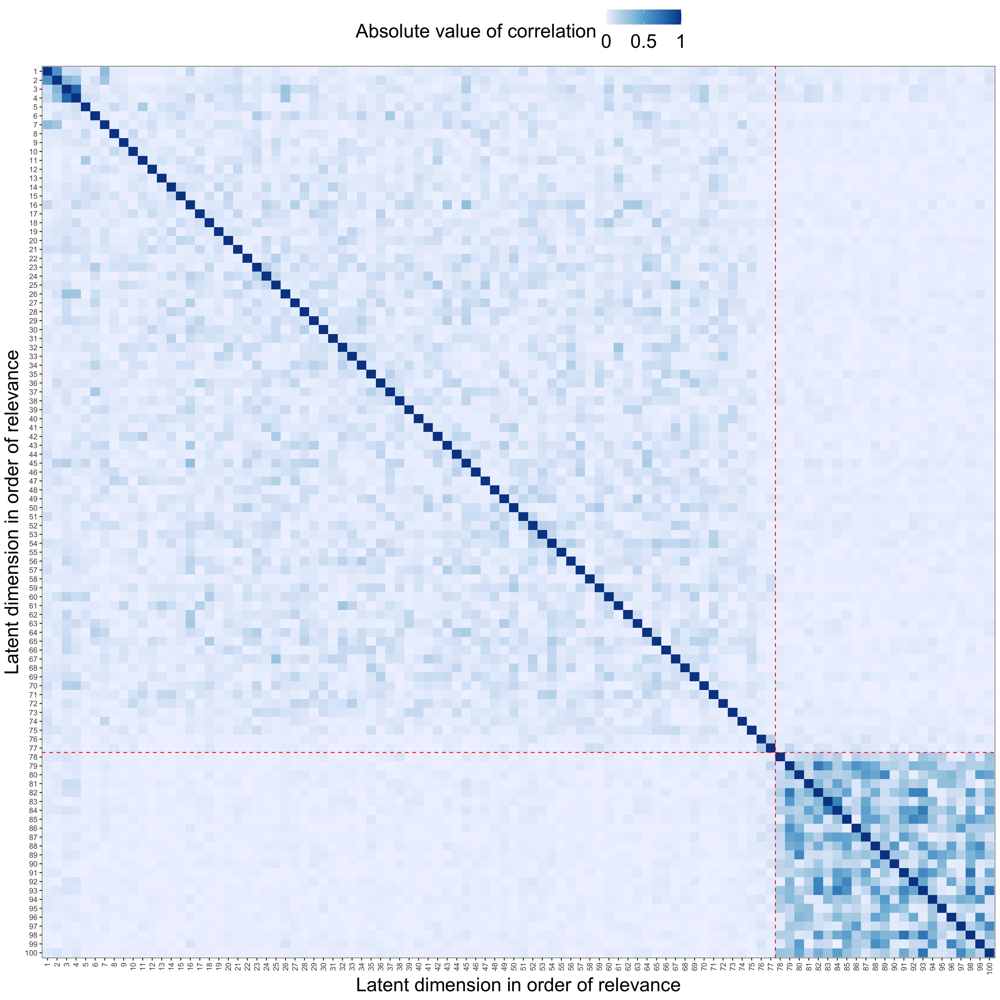

In [57]:
%%R -i corrs_neurons -w 16 -h 16 -u in -r 200

p_corrs = 
corrs_neurons %>%
pivot_longer(
    cols = !neuron_1,
    names_to = "neuron_2", 
    values_to = "correlation", 
    values_drop_na = FALSE
            ) %>%
mutate(neuron_1 = fct_relevel(neuron_1, order),
       neuron_2 = fct_relevel(neuron_2, order)
      ) %>%
filter(neuron_1 %in% order[0:n_tot] & neuron_2 %in% order[0:n_tot]) %>%
ggplot() +
    geom_raster(aes(x=neuron_1, y=neuron_2, fill=correlation)) +
    # scale_fill_viridis(direction=-1) +
   scale_fill_distiller(direction=1, name='Absolute value of correlation', limits=c(0,1), breaks=c(0, 0.5, 1), labels=c(0, 0.5, 1)) +
    theme(legend.position="top") +
    guides(x = guide_axis(angle = 90)) +
    theme(axis.title = element_text(size=rel(2)),
         legend.text = element_text(size=rel(2)),
        legend.title = element_text(size=rel(2))
         ) +
    scale_x_discrete(labels=seq(1,n_tot)) +
    geom_vline(xintercept = c(separation), color = "red", lty = "dashed") + #breaks=order, 
    geom_hline(yintercept = 1 + n_tot - separation, color = "red", lty = "dashed") + #breaks=order, 
    scale_y_discrete(labels=seq(n_tot,1), limits=rev) + #breaks=order, 
    labs(x=neuron_label, y=neuron_label) +
    theme(legend.position="top")

ggsave(here('figures', paste(n_bars, 'corrs_neurons.png', sep='_')), width=16, height=16, dpi=600)
ggsave(here('figures', paste(n_bars, 'corrs_neurons.pdf', sep='_')), width=16, height=16, dpi=600)
    
p_corrs


# Study symbolic features

In [58]:
#select those features that are scalar (no histograms), as we are looking for a short summary of musicality in a handful of numbers
cols = jsymb.columns
cols = cols[cols.str.contains('_1/')]
cols = cols[~cols.str.contains('/12')]
feat_cols = cols
data = jsymb[feat_cols]
data.columns = data.columns.str.replace('_1/1','')
cols = data.columns

print(f'{len(cols)} selected features:')
types = ['R','P','M']

rpm_features = []
for type in types:
    matches = list(cols[cols.str.contains(type)])
    rpm_features = rpm_features + matches
    print(f'\n{len(matches)} {type} features: {matches}')

features = data[rpm_features]
sorted_feats = features
sel_feats = features

feature_order = sel_feats.columns.to_list()

43 selected features:

10 R features: ['R15', 'R17', 'R18', 'R19', 'R20', 'R22', 'R23', 'R24', 'R25', 'R36']

16 P features: ['P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15', 'P16']

17 M features: ['M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'M10', 'M11', 'M12', 'M13', 'M14', 'M15', 'M17', 'M18', 'M19']


<IPython.core.display.Javascript object>

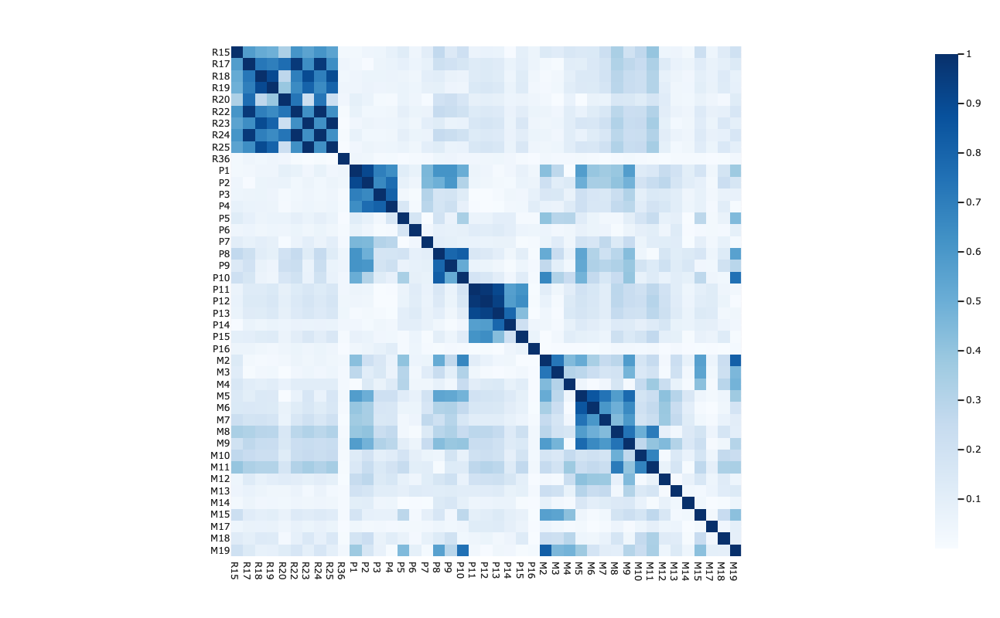

In [59]:
corrs = sel_feats.corr()
px.imshow(corrs.abs(),height=800)

interval columns not set, guessing: ['R15', 'R17', 'R18', 'R19', 'R20', 'R22', 'R23', 'R24', 'R25', 'R36', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15', 'P16', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'M10', 'M11', 'M12', 'M13', 'M14', 'M15', 'M17', 'M18', 'M19']


<IPython.core.display.Javascript object>

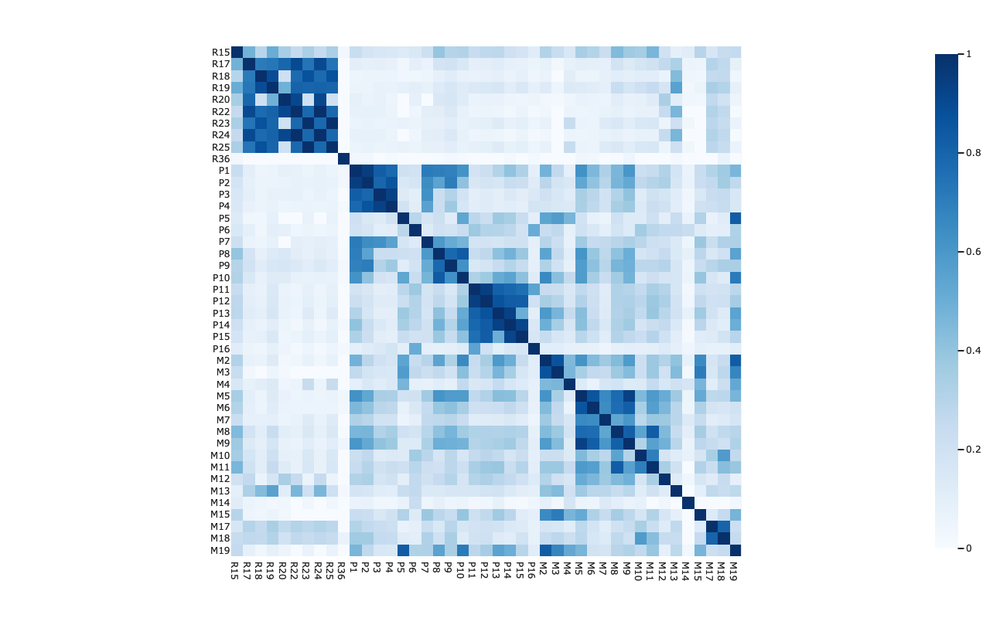

In [60]:
#corrs = sel_feats.corr()
corrs = sel_feats.phik_matrix()
corrs_for_R = corrs.reset_index().rename(columns={'index' : 'feature'})
px.imshow(corrs.abs(),height=800)

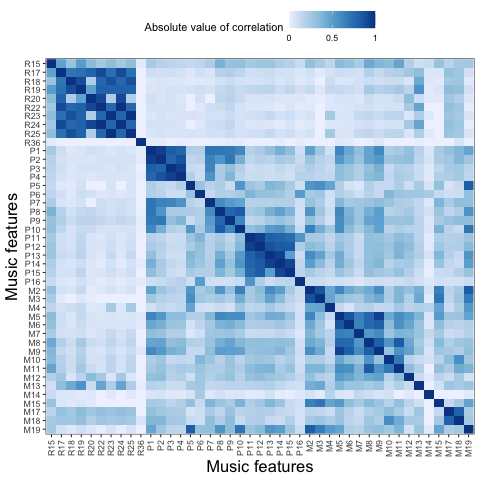

In [61]:
%%R -i corrs_for_R,feature_order 
#-w 16 -h 16 -u in -r 600

p_feature_corrs =
corrs_for_R %>% pivot_longer(
    cols = !feature,
    names_to = 'feature_',
    values_to = 'correlation'
                            ) %>% 
mutate(feature=fct_relevel(feature, feature_order),
      feature_=fct_relevel(feature_, feature_order)
      ) %>%
ggplot() +
    geom_raster(aes(feature, feature_, fill=correlation)) +
   scale_fill_distiller(direction=1, name='Absolute value of correlation', limits=c(0,1), breaks=c(0, 0.5, 1), labels=c(0, 0.5, 1)) +
    theme(legend.position="top") +
    scale_y_discrete(limits=rev) +
    guides(x = guide_axis(angle = 90)) +#scale_x_discrete(guide = guide_axis(angle = 90)) +
    theme(axis.title = element_text(size=rel(1.5))) +
    labs(x=feature_label, y=feature_label)

ggsave(here('figures', paste(n_bars, 'features_correlation.png', sep='_')), width=16, height=16)
ggsave(here('figures', paste(n_bars, 'features_correlation.pdf', sep='_')), width=16, height=16)

p_feature_corrs

# Correlations between latent coordinates and jsymb features

In [62]:
n_selected_latents = n_tot

sel_latents = encodings[order[:n_selected_latents]]
merged = sel_latents.reset_index().merge(sel_feats.reset_index(),how='inner')
if data_type == 'lmd_matched':
    merged = merged.set_index(encodings.index.names)
if data_type == 'fakes':
    merged = merged.set_index('index')

<h2>Read or compute cross-correlations</h2>

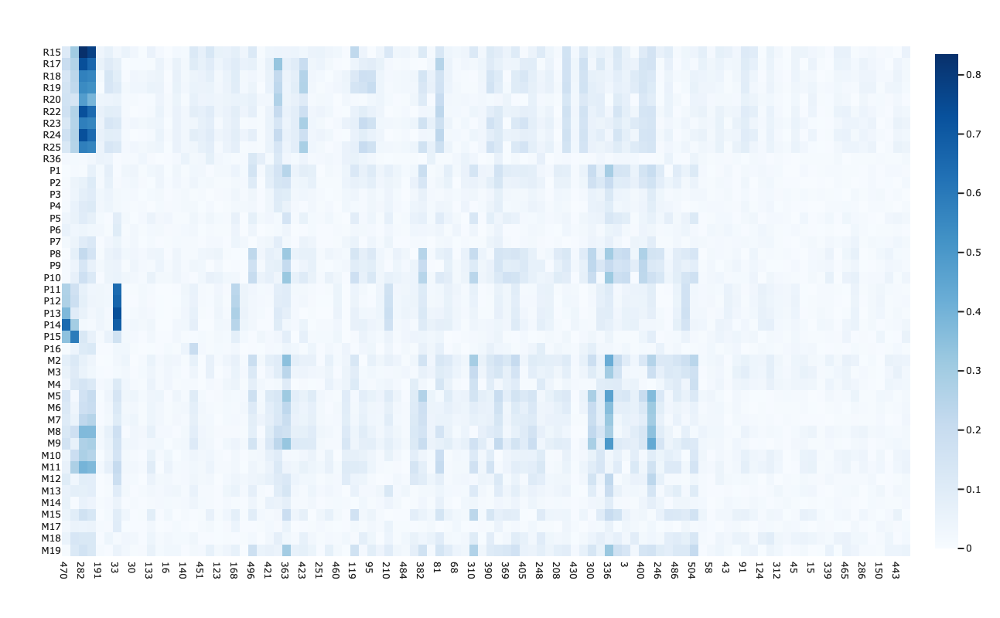

In [63]:
#compute correlations if needed
corrs_pearson = merged.corr().iloc[:sel_latents.shape[1],sel_latents.shape[1]:].abs()
corrs_pearson.to_parquet(path.joinpath('corrs_pearson.parquet'))
corrs = corrs_pearson
corrs_pearson.iloc[:100,:].T.plot(kind='imshow',aspect='auto',width = 800, height=800)#.update_yaxes(categoryorder='max descending')

In [64]:
corrs_phik = merged.phik_matrix().iloc[:sel_latents.shape[1],sel_latents.shape[1]:]
corrs_phik.to_parquet(path.joinpath('corrs_phik.parquet'))

interval columns not set, guessing: ['470', '507', '282', '14', '191', '289', '33', '163', '30', '394', '133', '477', '16', '118', '140', '297', '451', '398', '123', '101', '168', '355', '496', '82', '421', '280', '363', '272', '423', '502', '251', '335', '460', '165', '119', '203', '95', '356', '210', '13', '484', '18', '382', '235', '81', '249', '68', '147', '310', '412', '390', '275', '369', '97', '405', '403', '248', '263', '208', '281', '430', '155', '300', '154', '336', '185', '3', '236', '400', '314', '246', '107', '486', '69', '504', '474', '58', '309', '43', '341', '91', '37', '124', '320', '312', '453', '45', '233', '15', '301', '339', '198', '465', '255', '286', '351', '150', '164', '443', '131', 'R15', 'R17', 'R18', 'R19', 'R20', 'R22', 'R23', 'R24', 'R25', 'R36', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15', 'P16', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'M10', 'M11', 'M12', 'M13', 'M14', 'M15', 'M17', 'M18', 'M19']

<IPython.core.display.Javascript object>

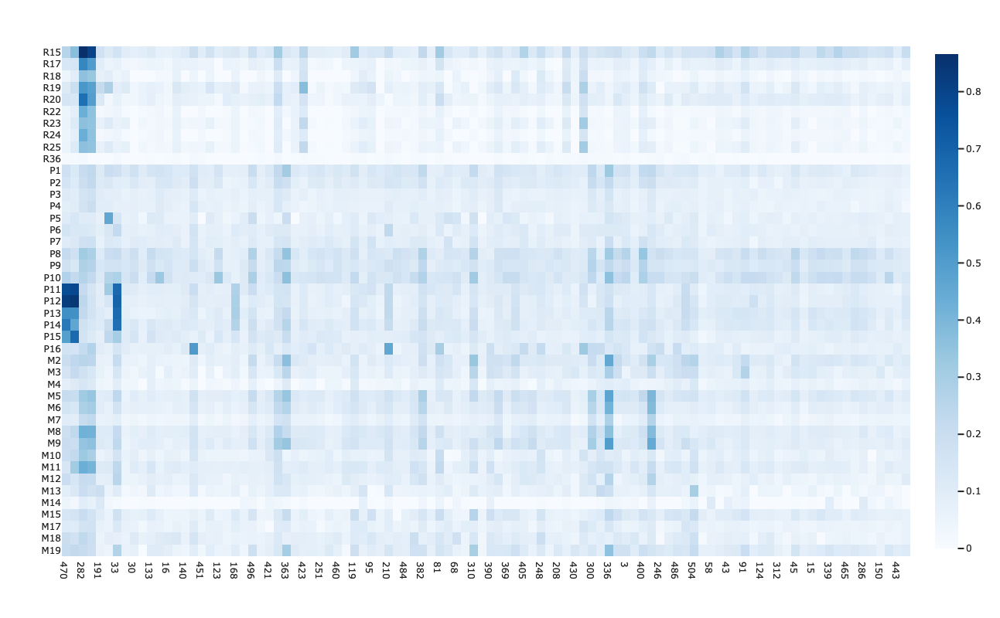

In [65]:
corrs_phik = pd.read_parquet(path.joinpath('corrs_phik.parquet'))
corrs_phik.iloc[:100,:].T.plot(kind='imshow',aspect='auto',width = 800, height=800)#.update_yaxes(categoryorder='max descending')

In [407]:
corrs = corrs_phik

In [66]:
cross_corrs = corrs.reset_index().rename(columns={'index' : 'neuron'})
cross_corrs

,neuron,R15,R17,R18,R19,R20,R22,R23,R24,R25,...,M9,M10,M11,M12,M13,M14,M15,M17,M18,M19
0,470,0.108514,0.194652,0.133894,0.152978,0.158912,0.171754,0.125254,0.171754,0.125254,...,0.154687,0.041529,0.063015,0.099766,0.056573,0.061498,0.048725,0.026104,0.053086,0.007567
1,507,0.306530,0.257500,0.235631,0.223173,0.142290,0.259312,0.252381,0.259312,0.252381,...,0.066596,0.185944,0.273477,0.032134,0.080422,0.005956,0.093762,0.049369,0.135565,0.116230
2,282,0.835083,0.736906,0.575178,0.544269,0.479227,0.733462,0.580505,0.733462,0.580505,...,0.269073,0.277378,0.394544,0.086128,0.074520,0.056628,0.165448,0.045200,0.127001,0.156413
3,14,0.780398,0.661275,0.560193,0.526581,0.391305,0.648523,0.564010,0.648523,0.564010,...,0.284522,0.253526,0.377020,0.083896,0.084736,0.043361,0.132895,0.050382,0.126668,0.124217
4,191,0.036314,0.060498,0.015627,0.002188,0.040927,0.064244,0.052007,0.064244,0.052007,...,0.019321,0.002916,0.019438,0.001231,0.001049,0.006849,0.002034,0.012908,0.004617,0.014006
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,351,0.024535,0.029479,0.043200,0.049253,0.013613,0.031277,0.051043,0.031277,0.051043,...,0.004724,0.005024,0.018270,0.024639,0.014704,0.016295,0.011206,0.002748,0.004893,0.010834
96,150,0.010437,0.018270,0.016842,0.007752,0.015011,0.014419,0.000867,0.014419,0.000867,...,0.013771,0.033242,0.032528,0.001310,0.032998,0.013485,0.002160,0.030108,0.010541,0.008319
97,164,0.011516,0.001005,0.017506,0.038428,0.009957,0.005483,0.012525,0.005483,0.012525,...,0.022039,0.000799,0.005534,0.003379,0.004786,0.007354,0.018545,0.021215,0.040804,0.045485
98,443,0.001381,0.042922,0.050110,0.042004,0.025853,0.037020,0.060146,0.037020,0.060146,...,0.027690,0.039244,0.031569,0.008113,0.023146,0.007947,0.059300,0.009999,0.005444,0.044866


In [67]:
%%R -i cross_corrs

cross = cross_corrs %>%
    as_tibble() %>%
    pivot_longer(
        cols = !neuron,
        names_to = 'feature',
        values_to = 'correlation'
    ) %>%
mutate(neuron=factor(neuron, order),
       feature=factor(feature, feature_order)
      )

cross

# A tibble: 4,300 × 3
   neuron feature correlation
   <fct>  <fct>         <dbl>
 1 470    R15          0.109 
 2 470    R17          0.195 
 3 470    R18          0.134 
 4 470    R19          0.153 
 5 470    R20          0.159 
 6 470    R22          0.172 
 7 470    R23          0.125 
 8 470    R24          0.172 
 9 470    R25          0.125 
10 470    R36          0.0166
# ℹ 4,290 more rows
# ℹ Use `print(n = ...)` to see more rows


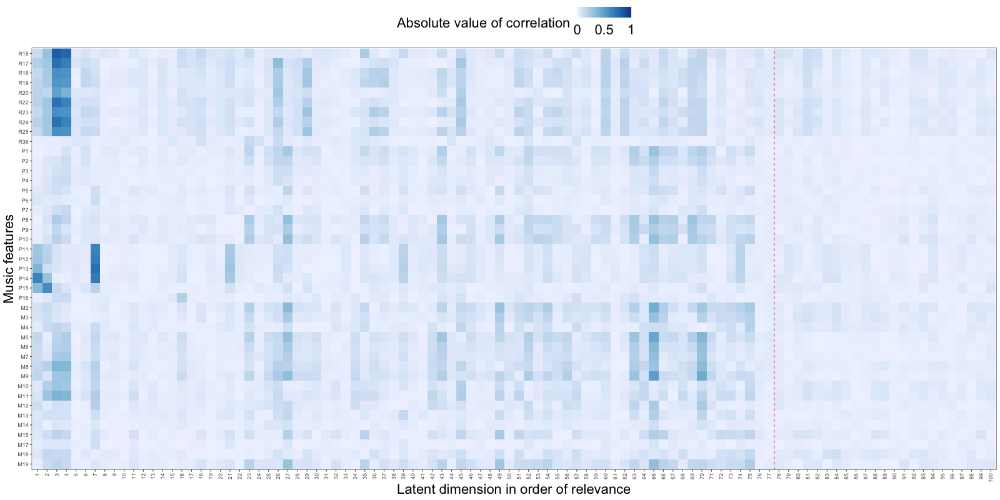

In [68]:
%%R -i n_bars -w 1600 -h 800

if (n_bars == '2bar'){n_lim = 37}
if (n_bars == '16bar'){n_lim = n_tot}

p_cross = cross %>%
    ggplot(aes(neuron, feature, fill=correlation)) +
    geom_raster() +
    scale_fill_distiller(direction=1, name='Absolute value of correlation', limits=c(0,1), breaks=c(0, 0.5, 1), labels=c(0, 0.5, 1)) +
    theme(legend.position="top") +
    guides(x = guide_axis(angle = 90)) +#scale_x_discrete(guide = guide_axis(angle = 90)) +
    theme(axis.title = element_text(size=rel(rel_size)),
          legend.title = element_text(size=rel(rel_size)),
          legend.text = element_text(size=rel(rel_size))
         )+
    scale_x_discrete(labels=seq(1,n_lim+1)) +#, limits = c(1, n_lim)) +
    coord_cartesian(xlim=c(1, n_lim)) +#, limits=seq(0,n_lim)) + #breaks=order, 
    scale_y_discrete(limits=rev) +
    geom_vline(xintercept = c(separation), color = "red", lty = "dashed") +
    labs(x=neuron_label, y=feature_label)

ggsave(here('figures', paste(n_bars, 'cross_corrs.png', sep='_')), width=8, height=8)
ggsave(here('figures', paste(n_bars, 'cross_corrs.pdf', sep='_')), width=8, height=8)

p_cross

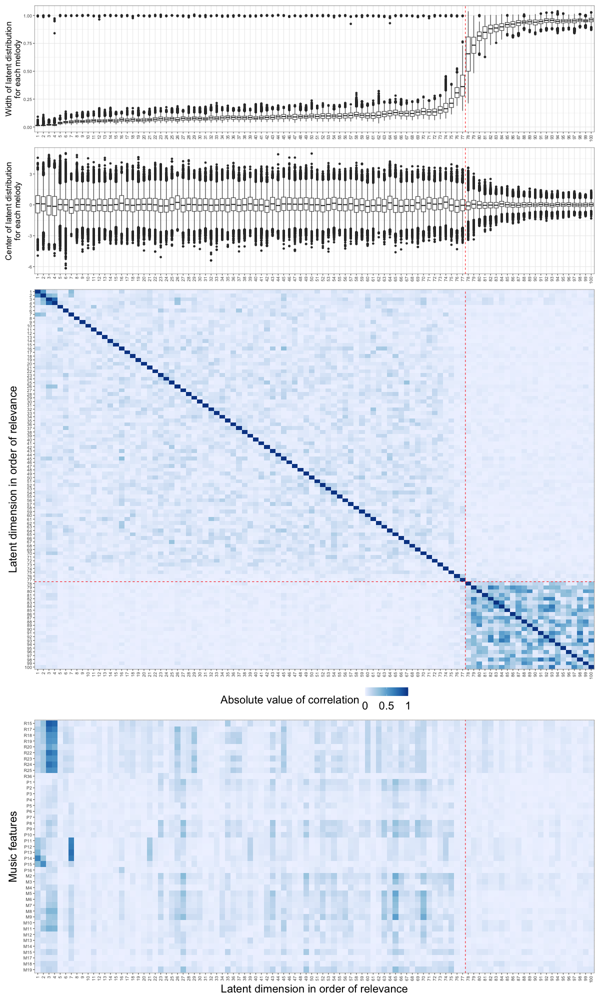

In [69]:
%%R -w 1200 -h 2000
p = (
    (p_sigmas + labs(x=NULL)) /
    (p_mus + labs(x=NULL)) /
    (p_corrs + labs(x=NULL) + theme(legend.position="none")) /
    p_cross + theme(legend.position="top")
    ) +
    plot_layout(heights = c(1, 1, 3, 2))
    
ggsave(here('figures',paste(n_bars, 'joined_plots.png', sep='_')), p, width=20, height=30, units='in')
ggsave(here('figures',paste(n_bars, 'joined_plots.pdf', sep='_')), p, width=20, height=30, units='in')

p

In [70]:
precise_latents = sorted_neurons[:n_relevant]
precise_latents

['470',
 '507',
 '282',
 '14',
 '191',
 '289',
 '33',
 '163',
 '30',
 '394',
 '133',
 '477',
 '16',
 '118',
 '140',
 '297',
 '451',
 '398',
 '123',
 '101',
 '168',
 '355',
 '496',
 '82',
 '421',
 '280',
 '363',
 '272',
 '423',
 '502',
 '251',
 '335',
 '460',
 '165',
 '119',
 '203',
 '95',
 '356',
 '210',
 '13',
 '484',
 '18',
 '382',
 '235',
 '81',
 '249',
 '68',
 '147',
 '310',
 '412',
 '390',
 '275',
 '369',
 '97',
 '405',
 '403',
 '248',
 '263',
 '208',
 '281',
 '430',
 '155',
 '300',
 '154',
 '336',
 '185',
 '3',
 '236',
 '400',
 '314',
 '246',
 '107',
 '486',
 '69',
 '504',
 '474',
 '58']

In [71]:
len(precise_latents)

77

In [72]:
top_corrs = corrs.loc[precise_latents,:].max(axis=1).nlargest(20)
top_corrs

282    0.835083
14     0.780398
33     0.734252
470    0.645214
507    0.594546
336    0.497314
314    0.435887
363    0.349665
280    0.330155
310    0.292172
423    0.283880
300    0.283354
168    0.274857
400    0.271275
382    0.261038
81     0.250242
504    0.239780
496    0.227922
119    0.223962
275    0.214067
dtype: float64

In [73]:
# extract the combinations with the top absolute correlations
abs_corrs_stacked = pd.DataFrame(corrs.loc[precise_latents,:].stack()).abs().reset_index()
abs_corrs_stacked.columns=['latent_dimension','feature','correlation']
data = abs_corrs_stacked.sort_values('correlation',ascending=False)
data.nlargest(10,'correlation')

<IPython.core.display.Javascript object>

,latent_dimension,feature,correlation
86,282,R15,0.835083
129,14,R15,0.780398
87,282,R17,0.736906
280,33,P13,0.734252
93,282,R24,0.733462
91,282,R22,0.733462
281,33,P14,0.687006
279,33,P12,0.666439
130,14,R17,0.661275
134,14,R22,0.648523


In [74]:
data.groupby('latent_dimension').correlation.max().nlargest(10)

latent_dimension
282    0.835083
14     0.780398
33     0.734252
470    0.645214
507    0.594546
336    0.497314
314    0.435887
363    0.349665
280    0.330155
310    0.292172
Name: correlation, dtype: float64

In [75]:
data.groupby('feature').correlation.max().nlargest(10)

feature
R15    0.835083
R17    0.736906
P13    0.734252
R22    0.733462
R24    0.733462
P14    0.687006
P12    0.666439
P11    0.645546
P15    0.594546
R23    0.580505
Name: correlation, dtype: float64

In [76]:
def top_corr(type):
    return data[data.feature.str[0]==type].nlargest(20,'correlation')

def top(type):
    return list(set(top_corr(type).feature.tolist()))

# for type in ['R','P','M']:
#     display(top_corr(type))
#     print(top(type))

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

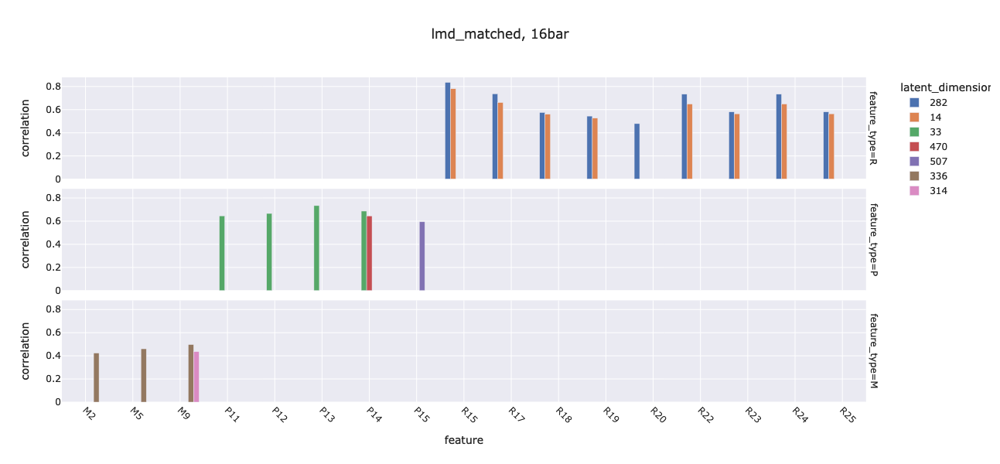

In [77]:
pio.templates.default = "seaborn"
px.defaults.width = 800
px.defaults.height = 600

#@title Choose threshold { run: "auto" }
threshold = 0.4 #@param {type:"slider", min:0, max:1, step:0.01}
data['feature_type'] = data.feature.str[0]
top_data = data[data.correlation>threshold].sort_values('feature_type')
main_latents = top_data.latent_dimension.value_counts().index.tolist()
fig = top_data.plot.bar(x='feature',y='correlation'
,color='latent_dimension',barmode='group'
,facet_row = 'feature_type'
,title=', '.join([data_type,n_bars])
,category_orders={"latent_dimension": data.latent_dimension
                  ,'feature_type' : ['R','P','M']
                 }
)\
.update_xaxes(categoryorder='category ascending')\
.update_xaxes(tickangle=45)
#fig.write_html(path.joinpath('_'.join(['correlations',data_type,n_bars])+'.html'))
fig.show()

In [78]:
print(corrs.shape)
print(corrs.isna().sum().sum())
 
#clean up if needed
corrs=corrs.dropna(axis='columns', how='all')
print(corrs.isna().sum().sum())
print(corrs.shape)

(100, 43)
0
0
(100, 43)


## Main neurons

In [79]:
def get_features(letter):
    return [f for f in rpm_features if f.startswith(letter)]

get_features('R')

['R15', 'R17', 'R18', 'R19', 'R20', 'R22', 'R23', 'R24', 'R25', 'R36']

In [80]:
from matplotlib import figure

def plot_acts(neuron, name_as,features,cols=4,height=800, opacity=.1):
    data = (merged[[neuron]+features]
            .melt(id_vars=neuron,var_name='jsymb_feature')
            # .rename(columns={neuron:"Neuron "+str(i)+ ' excitation"})
            .replace(
                feat_names['code'].tolist()
                ,feat_names['name'].tolist()
            )
            )
    fig = (data
            .plot.scatter(
                y=neuron
                ,x='value'
                ,facet_col='jsymb_feature'
                ,opacity=opacity,facet_col_wrap=cols
                ,trendline='lowess'
                ,trendline_color_override="red"
                ,facet_row_spacing=0.1
                ,labels = {neuron: 'Neuron '+str(name_as)+' excitation'}
            )
            .update_xaxes(matches=None,showticklabels=True,title_text='')
            .update_layout(width=1300,height=height)
            .for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]
                                                # ,y=-.05
                                                # ,yref="y domain",
                                                   ))
            )

    return fig

In [ ]:
stop running automatically here, as the next cells are very long to compute

In [82]:
for i, neuron in enumerate(order[:2]):
    for feature_type in ['R','P']:
        features = get_features(feature_type)
        fig = plot_acts(neuron, i+1, features)
        fig.show()
        fig.write_html(Path(fig_path / (n_bars + '_neuron_'+str(neuron)+'_renamed_as_'+str(i+1)+'_'+feature_type+'_features.html')))
        fig.write_image(fig_path / (n_bars + '_neuron_'+str(neuron)+'_renamed_as_'+str(i+1)+'_'+feature_type+'_features.pdf'))

ModuleNotFoundError: No module named 'statsmodels'

In [83]:
mapper = {feat_names['code'][i]: feat_names['name'][i] for i in range(feat_names.shape[0])}
merged = merged.rename(columns=mapper)

In [ ]:
%%R -i merged,feat_names -w 1400 -h 1200

for (chosen_neuron in 1:2){
    for (feature_type in c('R', 'P')){ #'P'
        if (feature_type == 'R'){height=8}
        if (feature_type == 'P'){height=12}

        merged %>%
            as.tibble(
            ) %>%
            rename(
                excitation = order[chosen_neuron]
            ) %>%
            select(
                starts_with(feature_type) | excitation
            ) %>%
            pivot_longer(
                cols = !excitation,
                names_to = 'feature_name',
                values_to = 'feature_value'
            ) %>%
            mutate(
                feature_name = fct_relevel(feature_name, feature_order)
            ) %>%
            ggplot(
                aes(feature_value, excitation)
            ) +
            geom_point(
                alpha = .1,
                color = 'blue'
            ) +
            geom_smooth(
                # method = 'loess',
                se = FALSE,
                color = 'red'
            ) +
            scale_fill_distiller(
                direction=1
            ) +
            facet_wrap(
                ~feature_name,
                scales = 'free',
                ncol=4
            ) +
            theme(
                legend.position = "none",
                axis.title = element_text(size=rel(2))
            ) +
            labs(
                x = 'Value of music feature',
                y = 'Central value of latent dimension',
                # title = 'Correlation between latent neuron and music features',
                # subtitle = paste('Neuron', chosen_neuron)
            )

        fig_name = paste(n_bars, 'neuron', chosen_neuron, 'on', feature_type, 'features', sep='_')
        ggsave(here('figures', paste(fig_name, '.png', sep='')), width=width, height=height)
        ggsave(here('figures', paste(fig_name, '.pdf', sep='')), width=width, height=height)
    }
}

In [237]:
%%R
fig_name = paste(n_bars, 'neuron', chosen_neuron, 'on', feature_type, 'features', sep='_')
ggsave(here('figures', paste(fig_name, '.png', sep='')), width=width, height=height)
ggsave(here('figures', paste(fig_name, '.pdf', sep='')), width=width, height=height)

`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'


From cffi callback <function _processevents at 0x7fa071fc47a0>:
Traceback (most recent call last):
  File "/Users/johannes/opt/anaconda3/envs/magenta/lib/python3.7/site-packages/rpy2/rinterface_lib/callbacks.py", line 275, in _processevents
    @ffi_proxy.callback(ffi_proxy._processevents_def,
KeyboardInterrupt


`geom_smooth()` using method = 'gam' and formula = 'y ~ s(x, bs = "cs")'


## Define attribute vectors

In [ ]:
#compute attribute vectors by looking at each features for all melodies, binning the melodies
#averaging the latent vectors for melodies within a bin, and taking the difference of average latent vectors for the two extreme bins

n_bins = 10
att_vects = pd.DataFrame()
successes = []

for feature in features.columns:
    name = '_'.join([feature,'extremes'])
    try:
        merged[name], boundaries = pd.qcut(merged[feature],n_bins,labels=False,duplicates='drop',retbins =True)
        grouped = merged.groupby(name)
        diff_extremes = grouped.get_group(len(boundaries)-2).mean() - grouped.get_group(0).mean()
        diff_extreme_bins = merged.groupby(name).mean().diff(periods=1).iloc[-1,:]
        att_vects = att_vects.append(diff_extreme_bins,ignore_index=True)
        successes.append(feature)
        print(f'{feature} successfully processed')
        
    except:
        print(f'{feature} skipped: issue with bin edge duplicates')

att_vects.insert(0,'feature',successes)
att_vects.set_index('feature',inplace=True)
att_vects = att_vects.T

In [ ]:
att_vects = att_vects.reindex(precise_latents)
att_vects

In [ ]:
att_vects.shape

In [ ]:
data = att_vects.transform(lambda x: (x-x.min())/(x.max()-x.min())).abs()#.loc[main_latents,:]
(px.imshow(data,aspect='auto')
)

In [ ]:
sorted_latents = att_vects.T.columns
sorted_latents

In [ ]:
att_vects = att_vects.reindex(index=sorted_latents,columns=feat_cols)
px.imshow(att_vects.pipe(np.abs).transform(lambda x: (x-x.min())/(x.max()-x.min())).iloc[:10,:],aspect='auto')

In [ ]:
att_corr = att_vects.phik_matrix()

In [ ]:
px.defaults.color_continuous_scale = px.colors.diverging.Portland
att_corr.plot(kind='imshow')

In [ ]:
sel_feats.phik_matrix().plot(kind='imshow')

## Reconstruct features from NN latent space using attribute vectors

In [ ]:
#rec_feats = sel_latents.dot(summary)
rec_feats = sel_latents.dot(att_vects)
joined_feats = sel_feats.join(rec_feats,how='inner',lsuffix='_measured',rsuffix='_NN')
joined_feats

In [ ]:
corrs = joined_feats.corr().iloc[rec_feats.shape[1]:,:rec_feats.shape[1]]
(corrs.loc['R15_1/1_NN','R15_1/1_measured'],corrs.loc['P13_1/1_NN','P13_1/1_measured'],corrs.loc['P12_1/1_NN','P12_1/1_measured'])

In [ ]:
for cols in [['R15_1/1_NN','R15_1/1_measured'],['P13_1/1_NN','P13_1/1_measured'],['P12_1/1_NN','P12_1/1_measured']]:
    x, y = joined_feats[cols].T.values
    print(phik.phik_from_array(x, y, num_vars=['x']))

In [ ]:
corrs = joined_feats.phik_matrix().iloc[rec_feats.shape[1]:,:rec_feats.shape[1]]
(corrs.loc['R15_1/1_NN','R15_1/1_measured'],corrs.loc['P13_1/1_NN','P13_1/1_measured'],corrs.loc['P12_1/1_NN','P12_1/1_measured'])

In [ ]:
corrs.stack().pipe(np.abs).sort_values(ascending=False).head(20)

In [ ]:
px.imshow(corrs.pipe(np.abs),aspect='auto',height=800)\
.update_xaxes(categoryorder = 'category ascending')\
.update_yaxes(categoryorder = 'category ascending')

## Plot features reconstructed from latent space against originals extracted by jsymb

In [ ]:
if data_type == 'lmd_matched':
    index_names = encodings.index.names
if data_type == 'fakes':
    index_names = ['index']

meas_feats = sel_feats.reset_index().melt(id_vars=index_names,var_name='feature',value_name = 'jsymb_measured').copy()
latent_feats = rec_feats.reset_index().melt(id_vars=index_names,var_name='feature',value_name = 'latent_reconstructed').copy()
data = meas_feats.merge(latent_feats,how='inner')

data

In [ ]:
feat = data.feature.unique()[0]
subset=data[data.feature == feat]
subset

In [ ]:
source = subset[["latent_reconstructed","jsymb_measured"]]
source.plot.scatter(x="latent_reconstructed",y='jsymb_measured')

In [ ]:
source.corr()

In [ ]:
subset=data[data.feature.isin(corrs[0][:5])]
fig=px.scatter(subset,x='jsymb_measured',y='latent_reconstructed',facet_col = 'feature', facet_col_wrap = 6, trendline='lowess',opacity=.01)
fig.update_xaxes(matches=None)
fig.update_yaxes(matches=None)
fig.show()

In [ ]:
hv.extension('bokeh')
subset=data[data.feature.str.contains('R15|R17|P8|P12|M2|M9|M10|M11|M12|M13')]
subset.hvplot.scatter(x='jsymb_measured',y='latent_reconstructed',by='feature',subplots=True,shared_axes=False,alpha=0.01,width=250).cols(7)

In [ ]:
corrs_R = corrs[corrs[0].str.contains('R')
px.bar(corrs_R,x=0,y=1)

In [ ]:
subset=data[data.feature.isin(corrs[0][:5])]
fig=px.scatter(subset,x='jsymb_measured',y='latent_reconstructed',facet_col = 'feature', facet_col_wrap = 6, trendline='lowess',opacity=.01)
fig.update_xaxes(matches=None)
fig.update_yaxes(matches=None)
fig.show()

In [ ]:
hv.extension('bokeh')
subset=data[data.feature.str.contains('R')]
subset.hvplot.scatter(x='jsymb_measured',y='latent_reconstructed',by='feature',subplots=True,shared_axes=False,alpha=0.01,width=250).cols(7)

In [ ]:
px.bar(corrs[corrs[0].str.contains('P')],x=0,y=1)

In [ ]:
subset=data[data.feature.isin(corrs[0][:5])]
fig=px.scatter(subset,x='jsymb_measured',y='latent_reconstructed',facet_col = 'feature', facet_col_wrap = 6, trendline='lowess',opacity=.01)
fig.update_xaxes(matches=None)
fig.update_yaxes(matches=None)
fig.show()

In [ ]:
hv.extension('bokeh')
subset=data[data.feature.str.contains('P')]
subset.hvplot.scatter(x='jsymb_measured',y='latent_reconstructed',by='feature',subplots=True,shared_axes=False,alpha=0.01,width=250).cols(7)

In [ ]:
px.bar(corrs[corrs[0].str.contains('M')],x=0,y=1)

In [ ]:
data

In [ ]:
subset=data[data.feature.isin(corrs[0][:5])]
fig=px.scatter(subset,x='jsymb_measured',y='latent_reconstructed',facet_col = 'feature', facet_col_wrap = 6, trendline='lowess',opacity=.01)
fig.update_xaxes(matches=None)
fig.update_yaxes(matches=None)
fig.show()

In [ ]:
subset=data[data.feature.str.contains('P8|P9|P11|P12')]
fig=px.scatter(subset,x='jsymb_measured',y='latent_reconstructed',facet_col = 'feature', facet_col_wrap = 6, trendline='lowess',opacity=.01)
fig.update_xaxes(matches=None)
fig.update_yaxes(matches=None)
fig.show()

In [ ]:
subset=data[data.feature.str.contains('R15|R17|R22')]

fig=px.scatter(subset,x='jsymb_measured',y='latent_reconstructed',facet_col = 'feature', facet_col_wrap = 6, trendline='lowess',opacity=0.01)
fig.update_xaxes(matches=None)
fig.update_yaxes(matches=None)
fig.show()

In [ ]:
hv.extension('bokeh')
subset=data[data.feature.str.contains('M')]
subset.hvplot.scatter(x='jsymb_measured',y='latent_reconstructed',by='feature',subplots=True,shared_axes=False,alpha=0.01,width=250).cols(7)

In [ ]:
subset=data[data.feature.isin(corrs[0][:5])]
fig=px.scatter(subset,x='jsymb_measured',y='latent_reconstructed',facet_col = 'feature', facet_col_wrap = 6, trendline='lowess',opacity=.01)
fig.update_xaxes(matches=None)
fig.update_yaxes(matches=None)
fig.show()

In [ ]:
!pip3 install datapane
import datapane as dp
dp.login(token='9cce56baa9d21b7035b9d08366ec7bca69ced16b')

renderer = hv.renderer("bokeh")

dp.Report(
  dp.Page(
    title="hvplot",
    blocks=["### plot", dp.HTML(renderer.html(chart))]
  )
, type=dp.ReportType.DASHBOARD).upload(name='Latent space of MusicVAE')

In [ ]:
summary

In [ ]:
# atribute vectors for first PCA of each tpe: R, P , M
pca = PCA(n_components=1,svd_solver='auto' )

rpm = pd.DataFrame()
projs=[]

types = ['R','P','M']
for type in types:
    list_cols = list(cols[cols.str.contains(type)])
    X = features[list_cols]
    proj=StandardScaler().fit_transform(X)
    proj = pd.DataFrame(pca.fit_transform(X), index = X.index,columns = [type])
    rpm = pd.concat([rpm, proj], axis=1)

    print(pca.singular_values_)
    print(pca.explained_variance_ratio_)
    print(pca.n_components_)


rpm
comps.shape

In [ ]:
px.bar(pd.DataFrame(pca.components_.transpose(),index = features.columns, columns = list_pcs),barmode='group')

In [ ]:
# Attribute vectors for PCA components of features
pca = PCA(n_components=3,svd_solver='auto' )
PCs = ['PC1','PC2','PC3']

summary = pd.DataFrame()

X = features
proj=StandardScaler().fit_transform(X)
proj=pca.fit_transform(X)
proj = pd.DataFrame(proj, index = X.index,columns = ['PC1','PC2','PC3'])

print(pca.singular_values_)
print(pca.explained_variance_ratio_)
print(pca.n_components_)

pcs = pd.concat([summary, proj], axis=1)

display(pcs)

In [ ]:
px.bar(pd.DataFrame(pca.components_.transpose(),index = features.columns, columns = list_pcs),barmode='group')

In [ ]:
merged = sel_latents.reset_index().merge(summary.reset_index(),how='inner')
if data_type == 'lmd_matched':
    merged = merged.set_index(encodings.index.names)
if data_type == 'fakes':
    merged = merged.set_index('index')
merged

In [ ]:
att_vects = pd.DataFrame()
successes = []

for feature in PCs:
    name = '_'.join([feature,'extremes'])
    try:
        merged[name], boundaries = pd.qcut(merged[feature],n_bins,labels=False,duplicates='drop',retbins =True)
        grouped = merged.groupby(name)
#        diff_extremes = grouped.get_group(len(boundaries)-2).mean() - grouped.get_group(0).mean()
        diff_extreme_bins = merged.groupby(name).mean().diff(periods=1).iloc[-1,:]
        att_vects = att_vects.append(diff_extreme_bins,ignore_index=True)
        successes.append(feature)
        print(f'{feature} successfully processed')
    except:
        print(f'{feature} skipped: issue with bin edge duplicates')

att_vects.insert(0,'feature',successes)
att_vects.set_index('feature',inplace=True)
att_vects = att_vects.iloc[:,:sel_latents.shape[1]].T

In [ ]:
px.bar(att_vects,barmode='group')

In [ ]:
att_vects_in_song_space = summary

In [ ]:
att_vects_in_latent_space = att_vects

In [ ]:
data = sel_latents.join(summary)
for type in types:
    data.plot.scatter(x=type,y='182')

In [ ]:
for type in types:
    data.plot.scatter(x=type,y='12')

In [ ]:
for type in types:
    data.plot.scatter(x=type,y='14')

In [ ]:
for type in types:
    data.plot.scatter(x=type,y='248')

In [ ]:
summary

In [ ]:
#compute attribute vectors by looking at each features for all melodies, binning the melodies
#averaging the latent vectors for melodies within a bin, and taking the difference of average latent vectors for the two extreme bins

n_bins = 10
sum_vects = pd.DataFrame()
successes = []

for feature in types:
    name = '_'.join([feature,'bins'])
    try:
        summary[name], boundaries = pd.qcut(summary[feature],n_bins,labels=False,duplicates='drop',retbins =True)
        grouped = summary.groupby(name)
        diff_extremes = grouped.get_group(len(boundaries)-2).mean() - grouped.get_group(0).mean()
        print(diff_extremes)
        diff_extreme_bins = grouped.mean().diff(periods=1).iloc[-1,:]
        print(diff_extreme_bins)
        sum_vects = sum_vects.append(diff_extreme_bins,ignore_index=True)
        print(sum_vects)
        successes.append(feature)
        print(f'{feature} successfully processed')
    except:
        print(f'{feature} skipped: issue with bin edge duplicates')

sum_vects.insert(0,'feature',successes)
sum_vects.set_index('feature',inplace=True)
sum_vects

In [ ]:
px.bar(new_vects[['R15_1/1','P13_1/1','M2_1/1']],barmode='group',width=1600)

In [ ]:
px.bar(att_vects,width=1600).show()

In [ ]:
for type in ['P','R','M']:
    px.bar(att_vects.iloc[:,att_vects.columns.str.contains(type)],width=1600).show()

In [ ]:
data = pd.DataFrame(MinMaxScaler().fit_transform(att_vects.pipe(np.abs)))
data.columns = att_vects.columns
px.imshow(data, aspect='auto',height=700).show()

In [ ]:
px.bar()

In [ ]:
sel_feats.columns

In [ ]:
def avg_per_type(feature):
    return att_vects.iloc[:,att_vects.columns.str.contains(feature)].mean(axis=1)

feature_names = ['R','P','M']

In [ ]:
for feature in feature_names:
    print(f'\n{feature}')
    display(avg_per_type(feature).pipe(np.abs).sort_values(ascending=False).head(5))

In [ ]:
sub = pd.DataFrame()
for feature in feature_names:
    sub = sub.append(avg_per_type(feature),ignore_index=True)

sub.insert(0,'feature',feature_names)
sub.set_index('feature',inplace=True)
sub = sub.T
sub

In [ ]:
px.bar(sub,barmode='group',width=1600)

In [ ]:
for feature in feature_names:
    temp = sub.sort_values(feature,ascending=False).reset_index(drop=True)
    px.imshow(temp.iloc[:50,:],aspect='auto').show()

In [ ]:
for feature in feature_names:
    sub = sub.sort_values(feature,ascending=False)
    sub.columns = range(512)
    sub = sub.iloc[:,:50]
    sub = sub.reset_index().melt(id_vars='feature')

    px.line(sub,x='variable',y='value',color='feature').show()

In [ ]:
for feature in feature_names:
    px.imshow(att_vects.iloc[:,att_vects.columns.str.contains(feature)].pipe(np.abs),aspect='auto').show()